# Introduction
In this notebook, we read a GRIB (.grb2) file containing weather data and plot it on top of a map of the world.

# Imports

## Imports to load data and general functionality

In [1]:
import pygrib
import os
import numpy as np

## Imports to use matplotlib to draw the plots and get country outlines

In [2]:
from matplotlib import pyplot as plt
from matplotlib import colors
from mpl_toolkits.basemap import Basemap, addcyclic

%matplotlib inline

## Imports for plotly plotting

In [3]:
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

# Read and briefly inspect data

In [4]:
data_folder = os.path.join(os.path.expanduser('~'), 'Documents', 'Projects', 'WeatherWind', 'data')

In [44]:
# downloaded from https://nomads.ncdc.noaa.gov/data/gfs-avn-hi/201805/20180508/
data_file = 'gfs_3_20180508_0600_027.grb2' 

In [45]:
grbs = pygrib.open(os.path.join(data_folder, data_file))
grb = grbs.readline()
lats,lons = grb.latlons()
grbs.close()

## Define a function that takes a list of pygrib.gribmessage objects and returns a dictionary, where the key 'data' contains a 3D tensor with data from the pygrib.gribmessage objects

In [46]:
def grb_to_grid(grb_obj):
    """Takes a single grb object containing multiple
    levels. Assumes same time, pressure levels. Compiles to a cube"""
    n_levels = len(grb_obj)
    levels = np.array([grb_element['level'] for grb_element in grb_obj])
    indexes = np.argsort(levels)[::-1] # highest pressure first
    cube = np.zeros([n_levels, grb_obj[0].values.shape[0], grb_obj[1].values.shape[1]])
    for i in range(n_levels):
        cube[i,:,:] = grb_obj[indexes[i]].values
    cube_dict = {'data' : cube, 'units' : grb_obj[0]['units'],
                 'levels' : levels[indexes]}
    return cube_dict

## Open the GRIB file

In [47]:
grbs = pygrib.open(os.path.join(data_folder, data_file))

In [48]:
grb = grbs.readline()

In [50]:
print(grb.hoursAfterDataCutoff)
print(grb.minutesAfterDataCutoff)
print(grb.forecastTime)
print(grb.level)
print(grb.typeOfLevel)

print("******")
print(grb.validDate) # date that forecast is for
print(grb.referenceValue)
print(grb.topLevel)
print(grb.bottomLevel)
print(grb.tempPressureUnits)

print("******")
print(grb.generatingProcessIdentifier)
print(grb.genVertHeightCoords)
print(grb.dataTime)
print(grb.dataDate)
print(grb.julianDay)

print("******")
print(grb.isHindcast)
print(grb.analDate) # date and time that forecast was issued


0
0
27
0
surface
******
2018-05-09 09:00:00
0.0
0
0
hPa
******
96
0
600
20180508
2458246.75
******
0
2018-05-08 06:00:00


In [15]:
grb.keys()

['globalDomain',
 'GRIBEditionNumber',
 'tablesVersionLatest',
 'grib2divider',
 'is_efas',
 'angularPrecision',
 'missingValue',
 'ieeeFloats',
 'isHindcast',
 'section0Length',
 'identifier',
 'discipline',
 'editionNumber',
 'totalLength',
 'sectionNumber',
 'section1Length',
 'numberOfSection',
 'centre',
 'centreDescription',
 'subCentre',
 'tablesVersion',
 'masterDir',
 'localTablesVersion',
 'significanceOfReferenceTime',
 'year',
 'month',
 'day',
 'hour',
 'minute',
 'second',
 'dataDate',
 'julianDay',
 'dataTime',
 'productionStatusOfProcessedData',
 'typeOfProcessedData',
 'md5Section1',
 'selectStepTemplateInterval',
 'selectStepTemplateInstant',
 'stepType',
 'setCalendarId',
 'deleteCalendarId',
 'is_uerra',
 'sectionNumber',
 'grib2LocalSectionPresent',
 'deleteLocalDefinition',
 'sectionNumber',
 'gridDescriptionSectionPresent',
 'section3Length',
 'numberOfSection',
 'sourceOfGridDefinition',
 'numberOfDataPoints',
 'numberOfOctectsForNumberOfPoints',
 'interpretatio

## View available data types

In [9]:
grbs.select()

[1:Visibility:m (instant):regular_ll:surface:level 0:fcst time 0 hrs:from 201805080000,
 2:U component of wind:m s**-1 (instant):regular_ll:unknown:level 0:fcst time 0 hrs:from 201805080000,
 3:V component of wind:m s**-1 (instant):regular_ll:unknown:level 0:fcst time 0 hrs:from 201805080000,
 4:Ventilation Rate:m**2 s**-1 (instant):regular_ll:unknown:level 0:fcst time 0 hrs:from 201805080000,
 5:Wind speed (gust):m s**-1 (instant):regular_ll:surface:level 0:fcst time 0 hrs:from 201805080000,
 6:Geopotential Height:gpm (instant):regular_ll:isobaricInhPa:level 100 Pa:fcst time 0 hrs:from 201805080000,
 7:Temperature:K (instant):regular_ll:isobaricInhPa:level 100 Pa:fcst time 0 hrs:from 201805080000,
 8:Relative humidity:% (instant):regular_ll:isobaricInhPa:level 100 Pa:fcst time 0 hrs:from 201805080000,
 9:U component of wind:m s**-1 (instant):regular_ll:isobaricInhPa:level 100 Pa:fcst time 0 hrs:from 201805080000,
 10:V component of wind:m s**-1 (instant):regular_ll:isobaricInhPa:level

## Get list of pygrib.gribmessage objects for the selected data type

In [10]:
data_type = "V component of wind"
grb_data = grbs.select(name=data_type)

## Read data from each pygrib.gribmessage object and return in 3D tensor using function defined above

In [11]:
grb_cube_data=grb_to_grid(grb_data)

### Inspect values of level

In [12]:
grb_cube_data['levels']

array([2147486,    3658,    3000,    2743,    1829,    1000,     975,
           950,     925,     900,     850,     800,     750,     700,
           650,     600,     550,     500,     450,     400,     350,
           300,     250,     200,     150,     100,     100,      80,
            70,      50,      30,      20,      10,       7,       5,
             3,       2,       2,       1,       1,       0,       0,
             0])

In [13]:
len(grb_cube_data['levels'])

43

In [14]:
len(np.unique(grb_cube_data['levels']))

38

### Inspect size of data and min and max values of latitude and longitude

In [15]:
grb_cube_data['data'].shape

(43, 181, 360)

In [16]:
min_lon = np.min(lons)
max_lon = np.max(lons)
min_lat = np.min(lats)
max_lat = np.max(lats)

In [17]:
[min_lon, max_lon, min_lat, max_lat]

[0.0, 359.0, -90.0, 90.0]

# Plot data

## Plot world map with overlaid temperature data using matplotlib

In [18]:
def plot_map_with_matplotlib(data, lats, lons, basemap_map):
    f = plt.figure(figsize=[12,10])
    x, y = basemap_map(lons, lats)

    my_mesh = basemap_map.pcolormesh(x, y, data)
    my_coast = basemap_map.drawcoastlines(linewidth=1.25)
    my_states = basemap_map.drawstates()
    
    my_p = basemap_map.drawparallels(
        np.arange(basemap_map.latmin, basemap_map.latmax,4), 
        labels=[1,1,0,0]) # latitude
    my_m = basemap_map.drawmeridians(
        np.arange(basemap_map.lonmin, basemap_map.lonmax, 4),
        labels=[0,0,0,1]) # longitude

    return f

In [19]:
m = Basemap(llcrnrlon = min_lon, llcrnrlat = min_lat, urcrnrlon = max_lon,
           urcrnrlat = max_lat , projection = 'mill', area_thresh =10000,
           resolution='l')

Text(0.5, 1.0, '2018-05-08 00:00:00')

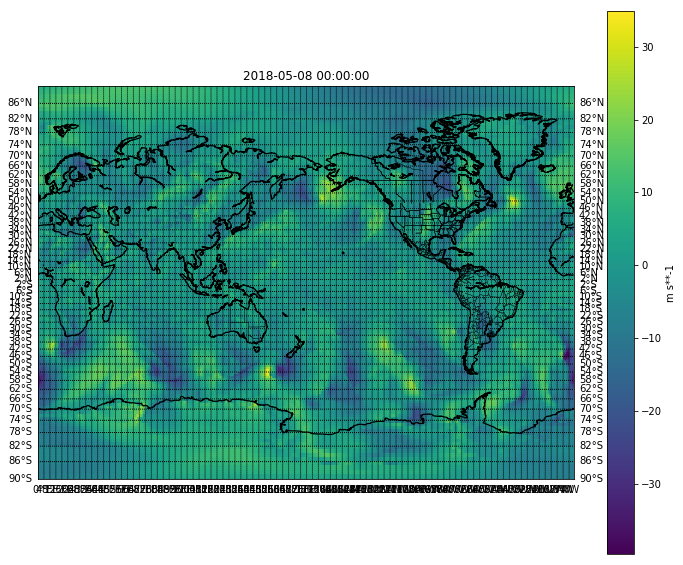

In [20]:
mpl_fig = plot_map_with_matplotlib(grb_cube_data['data'][10], lats, lons, m)

plt.colorbar(label=grb_cube_data['units'])
plt.title(grb.analDate)

## Plot world map with overlaid temperature data using plotly

Take data for one level from the cube to get temperature data in matrix format.

In [21]:
temp_data = grb_cube_data['data'][10]

### Define functions to return outlines of countries and coastlines, and call them

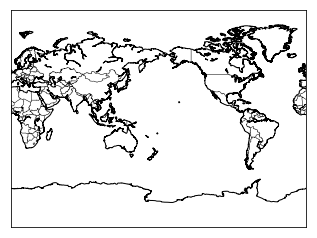

In [22]:
# Make shortcut to Basemap object, 
# not specifying projection type for this example
#m = Basemap(projection='mill',llcrnrlat=-90,urcrnrlat=90,
#            llcrnrlon=-180,urcrnrlon=180,resolution='l') #llcrnrlon = min_lon, llcrnrlat = min_lat, urcrnrlon = max_lon,
           #urcrnrlat = max_lat, area_thresh =10000,
           #resolution='l', projection="mill") 

# Make trace-generating function (return a Scatter object)
def make_scatter(x,y):
    return go.Scatter(
        x=x,
        y=y,
        mode='lines',
        line=go.scatter.Line(color="black"),
        name=' '  # no name on hover
    )

# Functions converting coastline/country polygons to lon/lat traces
def polygons_to_traces(poly_paths, N_poly, basemap_map):
    ''' 
    pos arg 1. (poly_paths): paths to polygons
    pos arg 2. (N_poly): number of polygon to convert
    '''
    traces = []  # init. plotting list 

    for i_poly in range(N_poly):
        poly_path = poly_paths[i_poly]
        
        # get the Basemap coordinates of each segment
        coords_cc = np.array(
            [(vertex[0],vertex[1]) 
             for (vertex,code) in poly_path.iter_segments(simplify=False)]
        )
        
        # convert coordinates to lon/lat by 'inverting' the Basemap projection
        lon_cc, lat_cc = basemap_map(coords_cc[:,0],coords_cc[:,1], inverse=True)
        
        # add plot.ly plotting options
        traces.append(make_scatter(lon_cc,lat_cc))
     
    return traces

# Function generating coastline lon/lat traces
def get_coastline_traces(basemap_map):
    poly_paths = basemap_map.drawcoastlines().get_paths() # coastline polygon paths
    N_poly = len(poly_paths) #91  # use only the 91st biggest coastlines (i.e. no rivers)
    return polygons_to_traces(poly_paths, N_poly, basemap_map)

# Function generating country lon/lat traces
def get_country_traces(basemap_map):
    poly_paths = basemap_map.drawcountries().get_paths() # country polygon paths
    N_poly = len(poly_paths)  # use all countries
    return polygons_to_traces(poly_paths, N_poly, basemap_map)

# Get list of of coastline and country lon/lat traces
traces_cc = get_coastline_traces(m)+get_country_traces(m)

### Define functions to extract max and min from list of traces defining coastlines and country outlines, and call them.

In [23]:
def get_max(dicts_list, field_name):
    cur_max = 0
    for trace in dicts_list:
        cur_max = np.max([np.max(trace[field_name]), cur_max])
    return cur_max

def get_min(dicts_list, field_name):
    cur_min = 0
    for trace in dicts_list:
        cur_min = np.min([np.min(trace[field_name]), cur_min])
    return cur_min
    
[get_min(traces_cc, 'y'), get_max(traces_cc, 'y'), get_min(traces_cc, 'x'), get_max(traces_cc, 'x')]

[-78.614501953125, 83.62683105468751, 0.0, 359.0]

### Define settings for plotly

In [24]:

title = data_type

anno_text = "Data from NOAA"
#"Data courtesy of \
#<a href='http://www.esrl.noaa.gov/psd/data/composites/day/'>\
#NOAA Earth System Research Laboratory</a>"

axis_style = dict(
    zeroline=False,
    showline=False,
    showgrid=False,
    ticks='',
    showticklabels=True,
)

layout = go.Layout(
    title=title,
    showlegend=False,
    hovermode="closest", # highlight closest point on hover
    margin = {'t':100, 'b':60, 'l':60, 'r':0, 'pad':8}, 
    xaxis=go.layout.XAxis(
        axis_style,
        range= [0, 360] # restrict y-axis to range of lon
    ),
    yaxis=go.layout.YAxis(
        axis_style,
        range=[-92, 92]
    ),
    annotations=[
        dict(
            text=anno_text,
            xref='paper',
            yref='paper',
            x=0,
            y=1,
            yanchor='bottom',
            showarrow=False
        )
    ],
    autosize=False,
    width=600,
    height=500
)

### Generate the plot with plotly

In [25]:
fig = go.Figure(data=traces_cc + [go.Contour(z=temp_data, x=lons[0, :], y=lats[:, 0])], layout=layout)

iplot(fig, filename="maps")

### Plot matplotlib plot again to compare

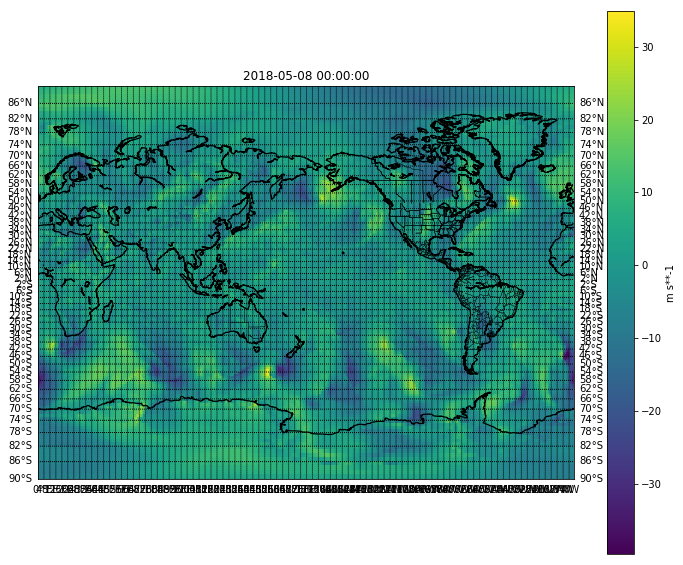

In [26]:
mpl_fig

## Plot on rotated map so that the middle of the Pacific Ocean is approximately aligned to the y-axis.

### Using matplotlib

In [27]:
m_rotated = Basemap(llcrnrlon = -179, llcrnrlat = min_lat, urcrnrlon = 180,
           urcrnrlat = max_lat , projection = 'mill', area_thresh =10000,
           resolution='l')

In [28]:
lons_rotated = lons.copy()
lons_rotated[lons >= 180] = lons[lons >= 180] - 360

# proper rotation obtained from: https://plot.ly/ipython-notebooks/basemap-maps/
i_east = lons_rotated[0, :] >= 0  # indices of east lon
i_west = lons_rotated[0, :] < 0   # indices of west lon
lons_rotated = np.hstack((lons_rotated[:, i_west], lons_rotated[:, i_east]))  # stack the 2 halves

# Correspondingly, shift the data array
tmp_data = grb_cube_data['data'][10]
data_rotated = np.hstack((tmp_data[:,i_west], tmp_data[:,i_east]))

Text(0.5, 1.0, '2018-05-08 00:00:00')

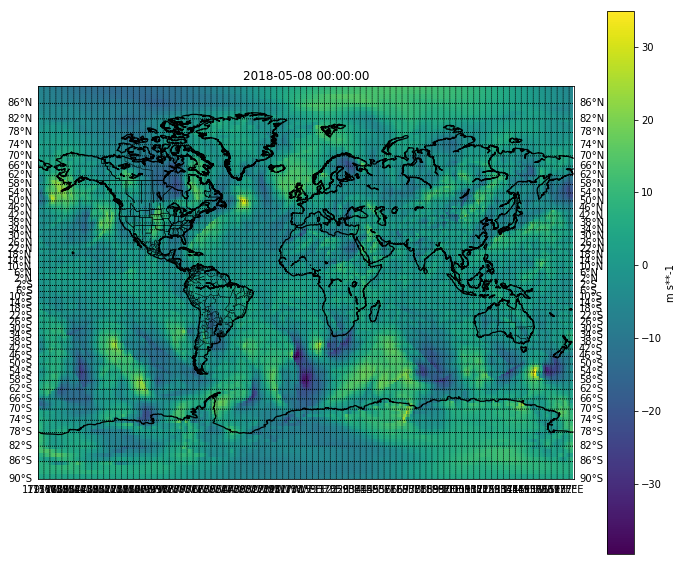

In [29]:
mpl_fig = plot_map_with_matplotlib(data_rotated, lats, lons_rotated, m_rotated)

plt.colorbar(label=grb_cube_data['units'])
plt.title(grb.analDate)

### Using plotly

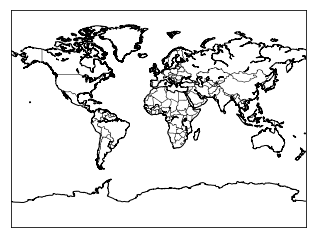

In [30]:
traces_cc = get_coastline_traces(m_rotated)+get_country_traces(m_rotated)

In [31]:
layout = go.Layout(
    title=title,
    showlegend=False,
    hovermode="closest", # highlight closest point on hover
    margin = {'t':100, 'b':60, 'l':60, 'r':0, 'pad':8}, 
    xaxis=go.layout.XAxis(
        axis_style,
        range = [-180, 180]  # restrict y-axis to range of lon
    ),
    yaxis=go.layout.YAxis(
        axis_style,
        range=[-92, 92]
    ),
    annotations=[
        dict(
            text=anno_text,
            xref='paper',
            yref='paper',
            x=0,
            y=1,
            yanchor='bottom',
            showarrow=False
        )
    ],
    autosize=False,
    width=600,
    height=500
)

In [32]:
fig = go.Figure(data=traces_cc + [go.Contour(z=data_rotated, x=lons_rotated[0, :], y=lats[:, 0])], layout=layout)

iplot(fig, filename="maps")

# Enable zooming on the plotly plot

In [33]:
import plotly.figure_factory as ff
fig = go.Figure(data=traces_cc + [go.Contour(z=data_rotated, x=lons_rotated[0, :], y=lats[:, 0])], layout=layout)

fig.layout.xaxis.fixedrange = False 
fig.layout.yaxis.fixedrange = False 

fig['layout']['xaxis']['fixedrange'] = False 
fig['layout']['yaxis']['fixedrange'] = False 
config = {'scrollZoom': True}
iplot(fig, filename="maps", config=config)